In [16]:
# Import Python pacakages
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler,PolynomialFeatures
from sklearn.linear_model import LinearRegression
%matplotlib inline

In [17]:
# Import all required files
# Read file 1 and assign it to variable "df"
df=pd.read_csv('housedata.csv')
# Read file 3 and assign it to variable "df2"
df2=pd.read_csv('houseprices2.csv')
# Read file 4 and assign it to variable "df3"
df3=pd.read_csv('houseprices3.csv')
# Read file 5 and assign it to variable "df4"
df4=pd.read_csv('houseprices4.csv')
# Read file 6 and assign it to variable "df5"

In [18]:
# Read first five rows of a large uk housing dataset
df.head(5)

,ID,Date,Price,Bedrooms,Bathrooms,Area,Floors,Waterfront,Condition,Council Tax Grade,Year Built,Year Rennovated
0,0,20181013,310660,3,1,110,1,0,3,7,1935,0
1,1,20181209,753200,3,2,239,2,0,3,7,1931,1995
2,2,20190225,252000,2,1,72,1,0,3,6,1913,0
3,3,20181209,845600,4,3,182,1,0,5,7,1945,0
4,4,20190218,714000,3,2,156,1,0,3,8,1967,0


In [19]:
# Show data types
df.dtypes

ID                   int64
Date                 int64
Price                int64
Bedrooms             int64
Bathrooms            int64
Area                 int64
Floors               int64
Waterfront           int64
Condition            int64
Council Tax Grade    int64
Year Built           int64
Year Rennovated      int64
dtype: object

In [20]:
# Run a desciptive analysis of the variables in the dataset
df.describe()

,ID,Date,Price,Bedrooms,Bathrooms,Area,Floors,Waterfront,Condition,Council Tax Grade,Year Built,Year Rennovated
count,21600.000000,2.160000e+04,2.160000e+04,21600.000000,21600.000000,21600.000000,21600.000000,21600.000000,21600.000000,21600.000000,21600.000000,21600.000000
mean,10806.910185,2.018390e+07,7.562334e+05,3.372870,2.313333,193.248519,1.542130,0.007546,3.409769,7.657454,1950.997407,84.537870
std,6239.589076,4.436639e+03,5.139769e+05,0.926657,0.864530,85.305997,0.567156,0.086543,0.650590,1.173983,29.373978,402.198256
min,0.000000,2.018050e+07,1.050000e+05,1.000000,0.000000,34.000000,1.000000,0.000000,1.000000,3.000000,1880.000000,0.000000
25%,5403.750000,2.018072e+07,4.508000e+05,3.000000,2.000000,133.000000,1.000000,0.000000,3.000000,7.000000,1931.000000,0.000000
50%,10808.500000,2.018102e+07,6.300000e+05,3.000000,2.000000,177.000000,2.000000,0.000000,3.000000,7.000000,1955.000000,0.000000
75%,16210.250000,2.019022e+07,9.030000e+05,4.000000,3.000000,237.000000,2.000000,0.000000,4.000000,8.000000,1977.000000,0.000000
max,21612.000000,2.019053e+07,1.078000e+07,33.000000,8.000000,1258.000000,4.000000,1.000000,5.000000,13.000000,1995.000000,2017.000000


In [21]:
# Check for NaN Values
print("number of NaN values for the column bedrooms :", df['Bedrooms'].isnull().sum())
print("number of NaN values for the column bathrooms :", df['Bathrooms'].isnull().sum())

number of NaN values for the column bedrooms : 0
number of NaN values for the column bathrooms : 0


In [22]:
# Count the number of houses by floors
UniqueHouses = df['Floors'].value_counts().to_frame()
print(UniqueHouses)

   Floors
1   10676
2   10145
3     772
4       7


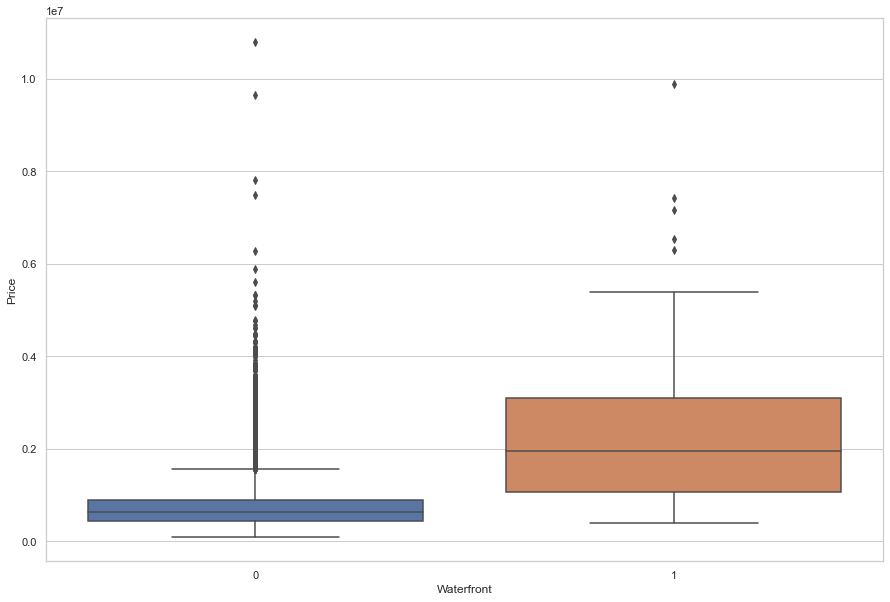

In [23]:
# Plot the range of property prices of those with a waterfront view versus those without. 1 = Waterfont
sns.set(style="whitegrid")
plt.figure(figsize=(15,10))
sns.boxplot(df['Waterfront'],df['Price'])

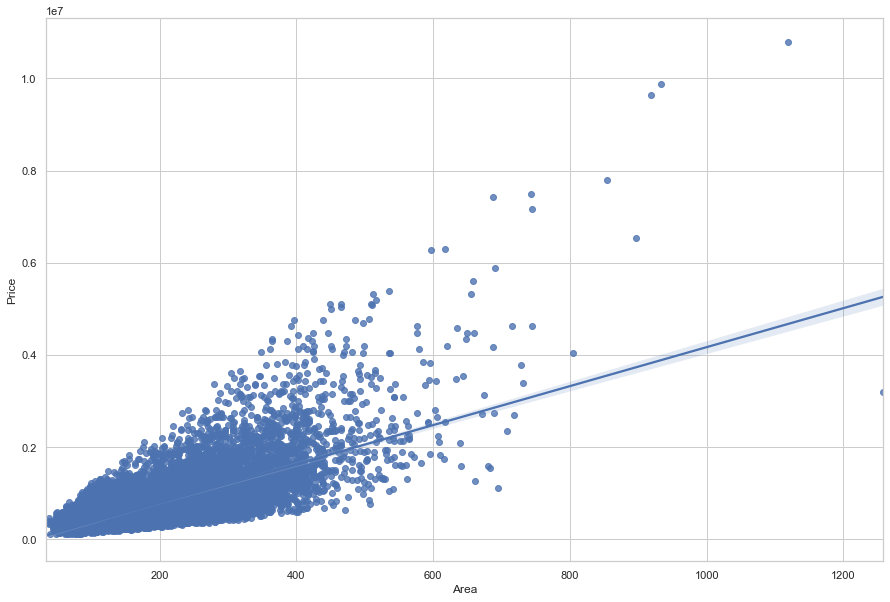

In [24]:
# Plot a regression betwwen area and price

sns.set(style="whitegrid")
plt.figure(figsize=(15,10))
sns.regplot(x='Area', y='Price', data=df)

In [25]:
# Run a correlation analysis of features versus price
df.corr()['Price'].sort_values()

Date                 0.003165
ID                   0.027573
Condition            0.036120
Year Built           0.054019
Year Rennovated      0.126428
Floors               0.258025
Waterfront           0.266432
Bedrooms             0.308890
Bathrooms            0.476001
Council Tax Grade    0.667764
Area                 0.701892
Price                1.000000
Name: Price, dtype: float64

In [26]:
# Fit a linear regression model to predict the price using the feature 'Area' then calculate the R^2. 
X = df[['Area']]
Y = df['Price']
lm = LinearRegression()
lm.fit(X,Y)
lm.score(X, Y)

0.49265237841157694

In [27]:
# establish multiple features for a multiple linear regression model 
features =["Floors", "Waterfront", "Bedrooms", "Bathrooms","Area", "Council Tax Grade"]    

In [28]:
# Fit a linear regression model to predict the price using the features, then calculate the R^2. 
X = df[["Floors", "Waterfront", "Bedrooms", "Bathrooms","Area", "Council Tax Grade"]]
Y = df['Price']
lm2 = LinearRegression()
lm2
lm2.fit(X,Y)
lm2.score(X, Y)

0.5824093543525721

In [29]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
print("done")

done


In [30]:
# Split the data into a training and test set to reduce algorithm being biased by current dataset
# Produce more accurate predicitons on new data

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.15, random_state=1)


print("number of test samples:", x_test.shape[0])
print("number of training samples:",x_train.shape[0])

number of test samples: 3240
number of training samples: 18360


In [31]:
#import  ridge regression model to reduce ridges in predictions
from sklearn.linear_model import Ridge

In [32]:
# Create, fit a ridge regression to the training data, regularization parameter to 0.1
# Calculate the R^2 using the test data.
RidgeRegression = Ridge(alpha=0.1)
RidgeRegression.fit(x_train,y_train)
RidgeRegression.score(x_test,y_test)

0.5815660570661149

In [33]:
# Perform a second order polynomial transformation on both the training data and testing data. 
# Create and fit a ridge regression to the training data, set the regularisation parameter to 0.1
# Calculate the R^2 utilising the test data. 
Poly = PolynomialFeatures(degree=2)
x_train_Poly = Poly.fit_transform(x_train)
x_test_Poly = Poly.fit_transform(x_test)
RidgeRegression2 = Ridge(alpha=0.1)
RidgeRegression2.fit(x_train_Poly, y_train)
RidgeRegression2.score(x_test_Poly, y_test)

0.5968109812152269

In [34]:
# import dataset of 10Y CAGR of UK house prices and equivalent mortgages, assuming 20% downpayment
df3

,Unnamed: 0,10 Y CAGR,10Y CAGR Mortgage
0,Average House,0.040,0.006
1,Detached,0.040,0.007
2,Semi Detached,0.040,0.006
3,Terraced,0.039,0.006
4,Flats,0.042,0.008
5,Salaries,0.023,0.023


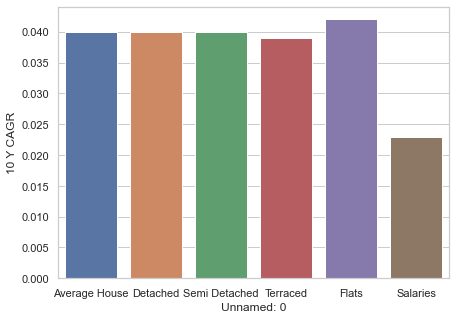

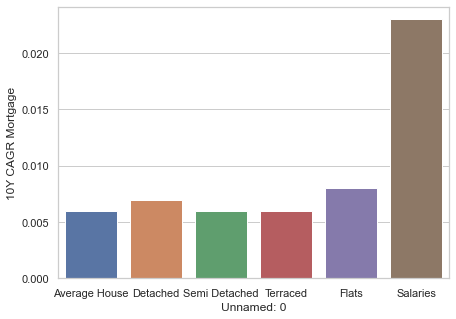

In [35]:
# Plot the compound increase in average house prices and other house type prices and salaries
# Plot the compound increase in average mortgage costs for average houses and house types and salaries
import matplotlib.ticker as mtick
sns.set(style="whitegrid")
plt.figure(figsize=(7,5))
sns.barplot(data=df3, x="Unnamed: 0", y="10 Y CAGR")

sns.set(style="whitegrid")
plt.figure(figsize=(7,5))
sns.barplot(data=df3, x="Unnamed: 0", y="10Y CAGR Mortgage")


In [36]:
# Contrary to popular belief, despite the increase in the price of housing, the increase in salary has actually outpaced the increase in mortgage costs in the past 10 years
# It is likely that the continual decline in interest rates drove house prices up.

In [37]:
# Load df2 dataset to compare median incomes and median house prices.
df2

,Local authorities,Code,Median,Detched,Semi Detached,Terrace,Flats,Median Income
0,County Durham,E06000047,120000,206531,119950,75000,82500,24000
1,Darlington,E06000005,140000,247500,134975,85000,99950,23541
2,Hartlepool,E06000001,128000,217500,127975,72500,95000,22258
3,Middlesbrough,E06000002,133000,220000,132000,70000,64000,21080
4,Northumberland,E06000057,167960,265050,145000,117500,95000,21943
...,...,...,...,...,...,...,...,...
334,Caerphilly,W06000018,135000,236250,145000,113250,92500,22639
335,Blaenau Gwent,W06000019,89475,209950,120000,77500,48000,19518
336,Torfaen,W06000020,150000,267500,162500,123500,80000,23422
337,Monmouthshire,W06000021,254998,335000,216500,182500,158000,26010


In [38]:
# Load df4 to compare how house prices have changed with interest rates and inflation.
df4.head

<bound method NDFrame.head of     Year  Interest Rate  Inflation Rate  Avg. House  Detached  Semi Detached  \
0   1960            NaN            0.01         NaN       NaN            NaN   
1   1961            NaN            0.03         NaN       NaN            NaN   
2   1962            NaN            0.04         NaN       NaN            NaN   
3   1963            NaN            0.02         NaN       NaN            NaN   
4   1964            NaN            0.03         NaN       NaN            NaN   
5   1965            NaN            0.05         NaN       NaN            NaN   
6   1966            NaN            0.04         NaN       NaN            NaN   
7   1967            NaN            0.02         NaN       NaN            NaN   
8   1968            NaN            0.05         NaN       NaN            NaN   
9   1969            NaN            0.05         NaN       NaN            NaN   
10  1970            NaN            0.06         NaN       NaN            NaN   
11  1971  

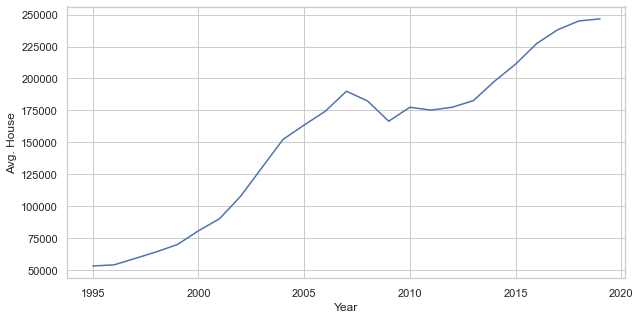

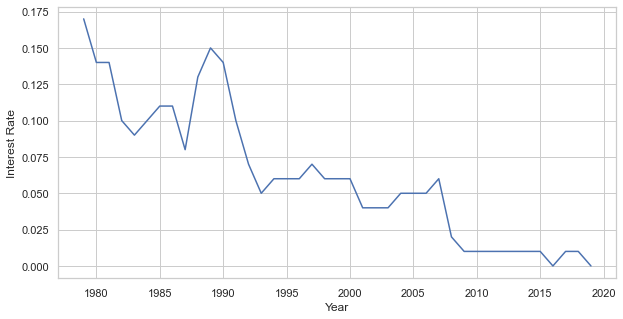

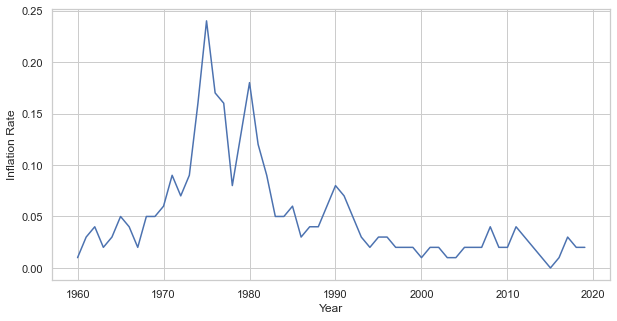

In [39]:
# Compare the increase in house prices since 1995 with interest rates since 1980 and inflation rates since 1960

sns.set(style="whitegrid")
plt.figure(figsize=(10,5))
sns.lineplot(data=df4, x="Year", y="Avg. House")

sns.set(style="whitegrid")
plt.figure(figsize=(10,5))
sns.lineplot(data=df4, x="Year", y="Interest Rate")

sns.set(style="whitegrid")
plt.figure(figsize=(10,5))
sns.lineplot(data=df4, x="Year", y="Inflation Rate")


In [40]:
#Import Bokeh as an exmaple
from bokeh.plotting import figure, output_file, show,output_notebook
output_notebook()

Loading BokehJS ...

In [41]:
x=df4["Year"]
y=df4["Avg. House"]

fig = figure (title="Average House Prices",
              x_axis_label="x",
              y_axis_label="y",
              width=800,
              height=400)

fig.line(x,y,
         line_alpha=0.8,
         legend_label="GBP",
         line_width=2)

show(fig)

In [42]:
#Import folium for maps
import folium # map rendering library

In [43]:
#Import the local area district json for the UK
eng_geo = 'lad.json' # geojson file

# create a plain world map with a zoom on Manchester
eng_map = folium.Map(location=[53.4794892, -2.2451148], zoom_start=11.5)

# generate a choropleth map using the median house prices by local discrict
eng_map.choropleth(
    geo_data=eng_geo,
    data=df2,
    columns=['Code', 'Median'],
    key_on='feature.properties.LAD13CD',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Median House Prices'
)
folium.LayerControl().add_to(eng_map)
# display map
eng_map

C:\Users\colin\anaconda3\lib\site-packages\folium\folium.py:411: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [44]:
#Import the local area district json for the UK
eng_geo = 'lad.json' # geojson file

# create a plain world map
eng_map = folium.Map(location=[53.4794892, -2.2451148], zoom_start=11.5)

# generate choropleth map using the median income by local discrict
eng_map.choropleth(
    geo_data=eng_geo,
    data=df2,
    columns=['Code', 'Median Income'],
    key_on='feature.properties.LAD13CD',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Median Income'
)
folium.LayerControl().add_to(eng_map)
# display map
eng_map

In [45]:
df6.head()

,Year,Interest Rate,Inflation Rate,Avg. House,Detached,Semi Detached,Terraced,Flats
0,1960,NaN,0.01,NaN,NaN,NaN,NaN,NaN
1,1961,NaN,0.03,NaN,NaN,NaN,NaN,NaN
2,1962,NaN,0.04,NaN,NaN,NaN,NaN,NaN
3,1963,NaN,0.02,NaN,NaN,NaN,NaN,NaN
4,1964,NaN,0.03,NaN,NaN,NaN,NaN,NaN


In [46]:
# Calculate the correlation between median house price and median income
df2[["Median", "Median Income" ]].corr()

,Median,Median Income
Median,1.000000,0.820213
Median Income,0.820213,1.000000


In [47]:
# Fit a linear regression model to predict the median house price using the feature 'Median Income' then calculate the R^2. 
X = df2[['Median Income']]
Y = df2['Median']
lm = LinearRegression()
lm.fit(X,Y)
lm.score(X, Y)

0.6727497197664518